# In this notebook we did:
 - Pairplots of proteins in the combined dataset


In [90]:
# Import the packages we may need
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


In [91]:
df2 = pd.read_csv('Combined_df2.csv')

In [51]:
print("Original DataFrame:")
print(df2)

# Calculate the halfway point
halfway_index = len(df2.columns) // 2  # Integer division

# Select columns up to the halfway point
first_half = df2.iloc[:, :halfway_index]  # Select columns from start to halfway
print("\nFirst Half of Columns:")
first_half

# Select columns after the halfway point
second_half = df2.iloc[:, halfway_index:]  # Select columns from halfway to end
print("\nSecond Half of Columns:")
#print(second_half)

Original DataFrame:
      Unnamed: 0.1  Unnamed: 0     Sample_ID Cancer    Q15389   P29965  \
0                0         0.0         PM910   Ctrl  10.12895  5.62622   
1                1         1.0         PM396   Ctrl   8.67289  5.18821   
2                2         2.0         PM190   Ctrl   9.99567  6.38876   
3                3         3.0         PM270   Ctrl   8.26407  5.06228   
4                4         4.0         PM656   Ctrl   9.08833  5.95005   
...            ...         ...           ...    ...       ...      ...   
1900           162         NaN  C29ZZ80Y4.01   HODG   9.87819  7.15139   
1901           163         NaN  C29ZS2ML8.01   HODG   9.42403  6.16559   
1902           164         NaN  C29ZFFZ0Q.01   HODG  10.26858  8.11759   
1903           165         NaN  C29ZQOG4N.01   HODG  10.15491  7.09910   
1904           166         NaN  C29ZPXKPU.01   HODG   9.91994  8.26728   

       P49763   Q02763    P01127    P09341  ...   P09382   Q16790    P26842  \
0     7.7290

In [83]:
df_dropped = df2.drop(df2.columns[:2], axis=1)
df_dropped

,Sample_ID,Cancer,Q15389,P29965,P49763,Q02763,P01127,P09341,O00182,Q14116,...,P09382,Q16790,P26842,P14210,P43489,O75144,O43927,P32970,Q8WXI7,P10144
0,PM910,Ctrl,10.12895,5.62622,7.72902,8.47530,10.08926,10.58751,8.65712,7.81074,...,8.54519,4.20874,10.61404,8.37166,4.99296,7.78219,7.03584,4.81481,3.58965,4.13563
1,PM396,Ctrl,8.67289,5.18821,8.25523,9.06271,8.89866,9.22360,8.46706,8.18828,...,8.25401,3.46839,10.77271,8.36820,4.92422,7.47997,8.05700,3.98900,4.78155,3.14840
2,PM190,Ctrl,9.99567,6.38876,8.44263,8.42102,10.08508,10.43894,9.09830,9.15899,...,8.75887,4.65936,11.03062,9.18464,5.60743,7.92803,8.77261,4.80189,5.16350,4.29062
3,PM270,Ctrl,8.26407,5.06228,8.13429,8.66165,8.75925,9.24310,8.72250,8.57028,...,8.75741,4.44633,10.47952,8.65548,5.54289,9.29458,8.64028,4.04045,5.59217,3.75295
4,PM656,Ctrl,9.08833,5.95005,8.37830,8.29127,9.43936,9.83732,8.80904,8.18094,...,8.48018,3.81634,10.59295,8.63758,5.16271,7.41098,8.29143,4.59594,4.91665,4.10381
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1900,C29ZZ80Y4.01,HODG,9.87819,7.15139,7.71189,7.72042,10.23705,7.66455,7.96187,8.03016,...,7.19963,4.26576,7.80544,9.24521,5.59883,5.16395,9.03873,4.24414,1.53814,5.30002
1901,C29ZS2ML8.01,HODG,9.42403,6.16559,7.48199,7.30005,10.14143,7.84437,7.17525,7.93368,...,6.90334,4.14795,7.74788,8.80026,5.18470,7.53391,7.97077,3.84446,3.41778,3.84928
1902,C29ZFFZ0Q.01,HODG,10.26858,8.11759,7.78457,7.46200,10.25920,8.15014,7.59132,8.38650,...,6.69773,3.60838,7.67268,7.83666,5.35574,5.27098,7.55698,3.11025,1.56641,4.23022
1903,C29ZQOG4N.01,HODG,10.15491,7.09910,7.78078,7.45732,10.27589,8.17975,7.56307,8.67965,...,7.01314,5.67411,8.44027,8.79263,5.66616,7.99492,8.71554,5.02993,3.94930,4.90380


In [16]:
first_16_columns = df_dropped.columns[:18]  # Get the first 16 column names
print("First 16 Column Names:")
print(first_16_columns.tolist()) 

First 16 Column Names:
['Sample_ID', 'Cancer', 'Q15389', 'P29965', 'P49763', 'Q02763', 'P01127', 'P09341', 'O00182', 'Q14116', 'P09601', 'Q92583', 'P10147', 'P09237', 'P07585', 'P39900', 'Q9BQ51', 'P01730']


In [54]:
# Calculate split indices
total_columns = len(df_dropped.columns)
split1 = total_columns // 4              # First split index
split2 = total_columns // 2               # Second split index
split3 = 3 * total_columns // 4           # Third split index

# Create four new DataFrames
df_part1 = df_dropped.iloc[:, :split1]            # First part
df_part2 = df_dropped.iloc[:, split1:split2]      # Second part
df_part3 = df_dropped.iloc[:, split2:split3]      # Third part
df_part4 = df_dropped.iloc[:, split3:]             # Fourth part

# Display the split DataFrames
print("\nFirst Part of DataFrame:")
print(df_part1)

print("\nSecond Part of DataFrame:")
print(df_part2)

print("\nThird Part of DataFrame:")
print(df_part3)

print("\nFourth Part of DataFrame:")
print(df_part4)


First Part of DataFrame:
         Sample_ID Cancer    Q15389   P29965   P49763   Q02763    P01127  \
0            PM910   Ctrl  10.12895  5.62622  7.72902  8.47530  10.08926   
1            PM396   Ctrl   8.67289  5.18821  8.25523  9.06271   8.89866   
2            PM190   Ctrl   9.99567  6.38876  8.44263  8.42102  10.08508   
3            PM270   Ctrl   8.26407  5.06228  8.13429  8.66165   8.75925   
4            PM656   Ctrl   9.08833  5.95005  8.37830  8.29127   9.43936   
...            ...    ...       ...      ...      ...      ...       ...   
1900  C29ZZ80Y4.01   HODG   9.87819  7.15139  7.71189  7.72042  10.23705   
1901  C29ZS2ML8.01   HODG   9.42403  6.16559  7.48199  7.30005  10.14143   
1902  C29ZFFZ0Q.01   HODG  10.26858  8.11759  7.78457  7.46200  10.25920   
1903  C29ZQOG4N.01   HODG  10.15491  7.09910  7.78078  7.45732  10.27589   
1904  C29ZPXKPU.01   HODG   9.91994  8.26728  8.24490  7.38531  10.22731   

        P09341   O00182   Q14116    P09601    Q92583  
0     

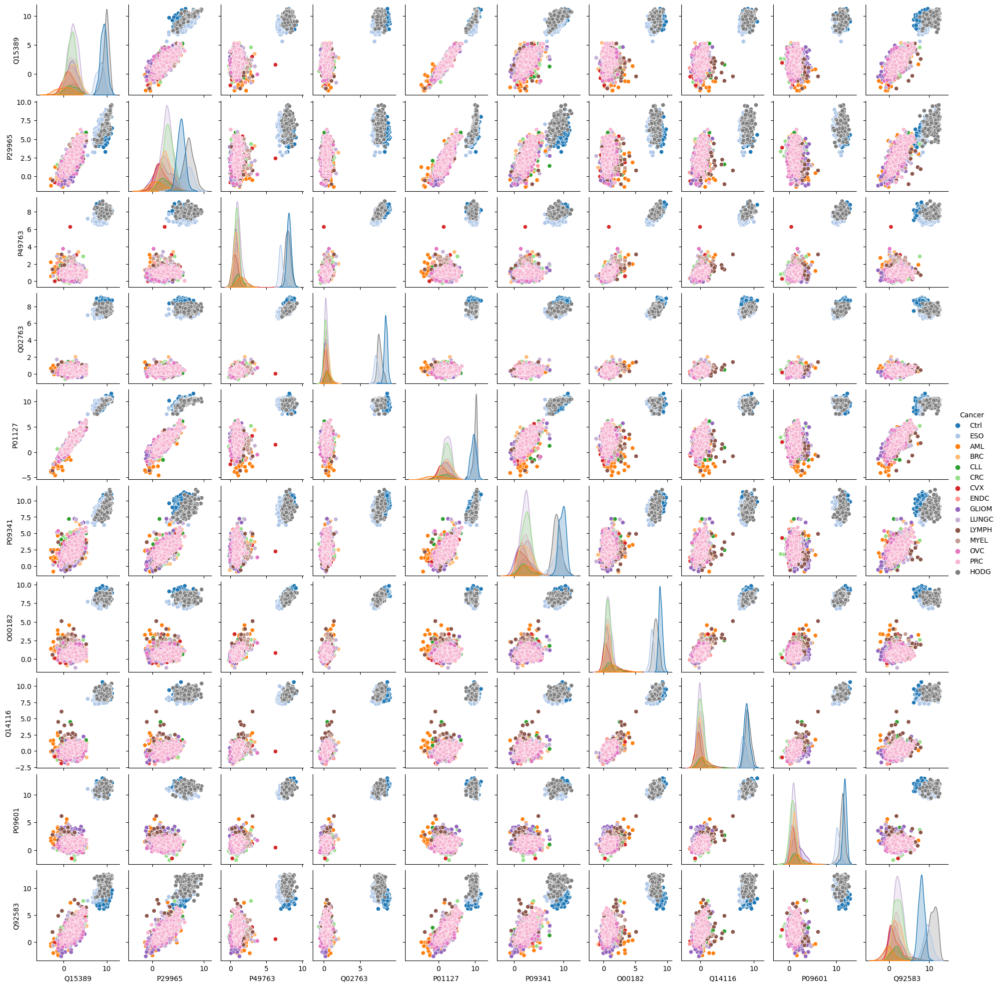

In [71]:
import seaborn as sns
sns.pairplot(df_part1, hue= "Cancer", palette="tab20", )
fig = plt.gcf()
fig.set_size_inches(20, 20)
plt.show()

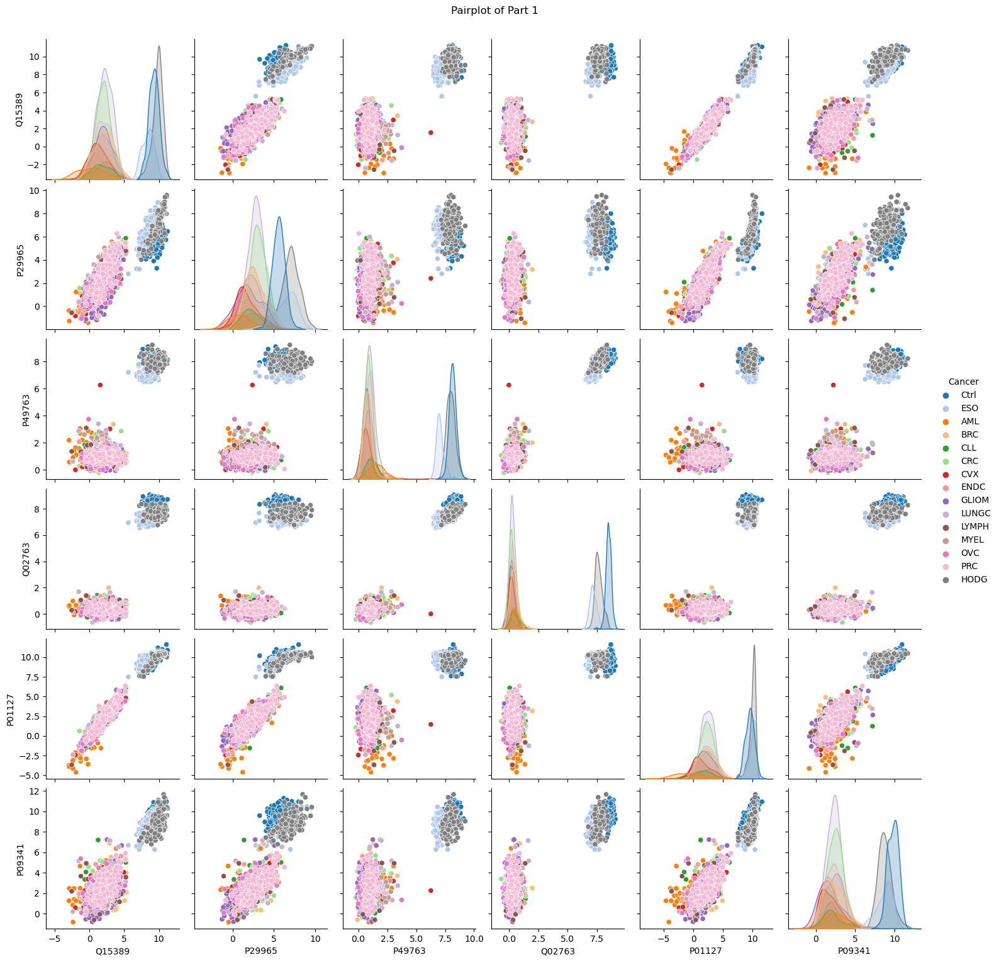

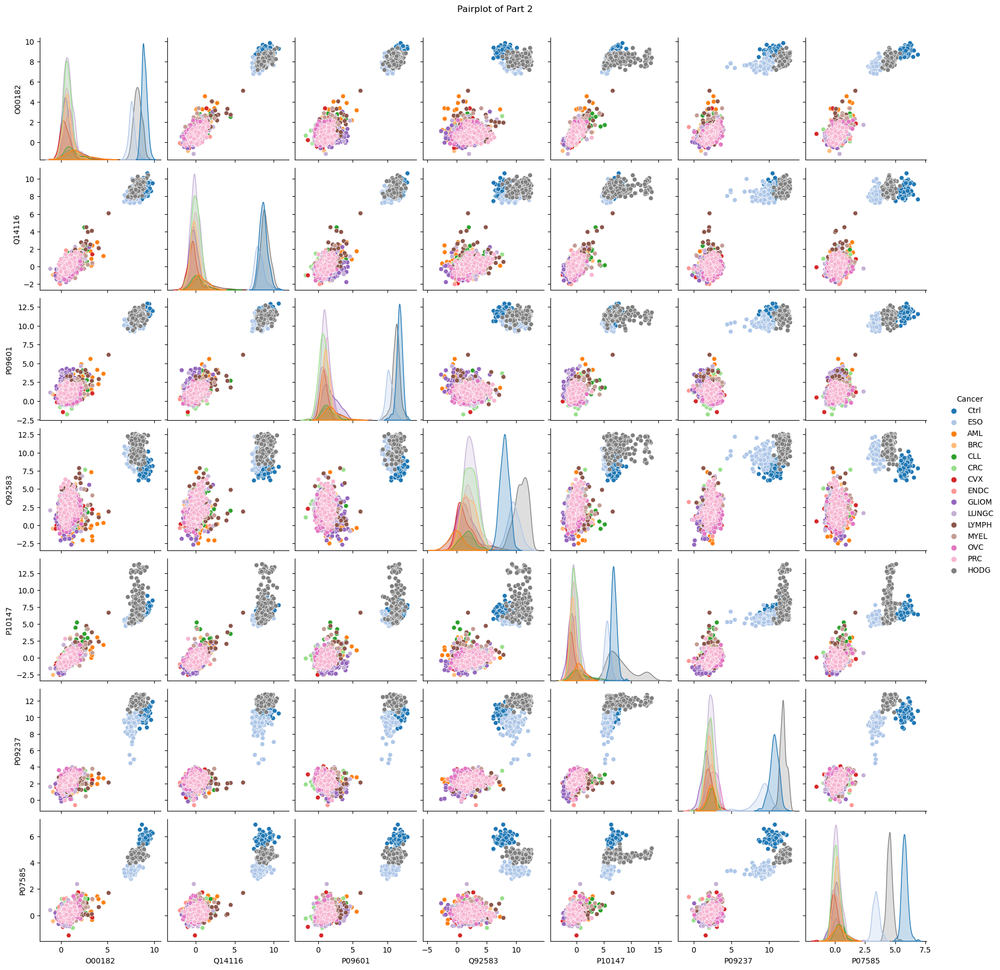

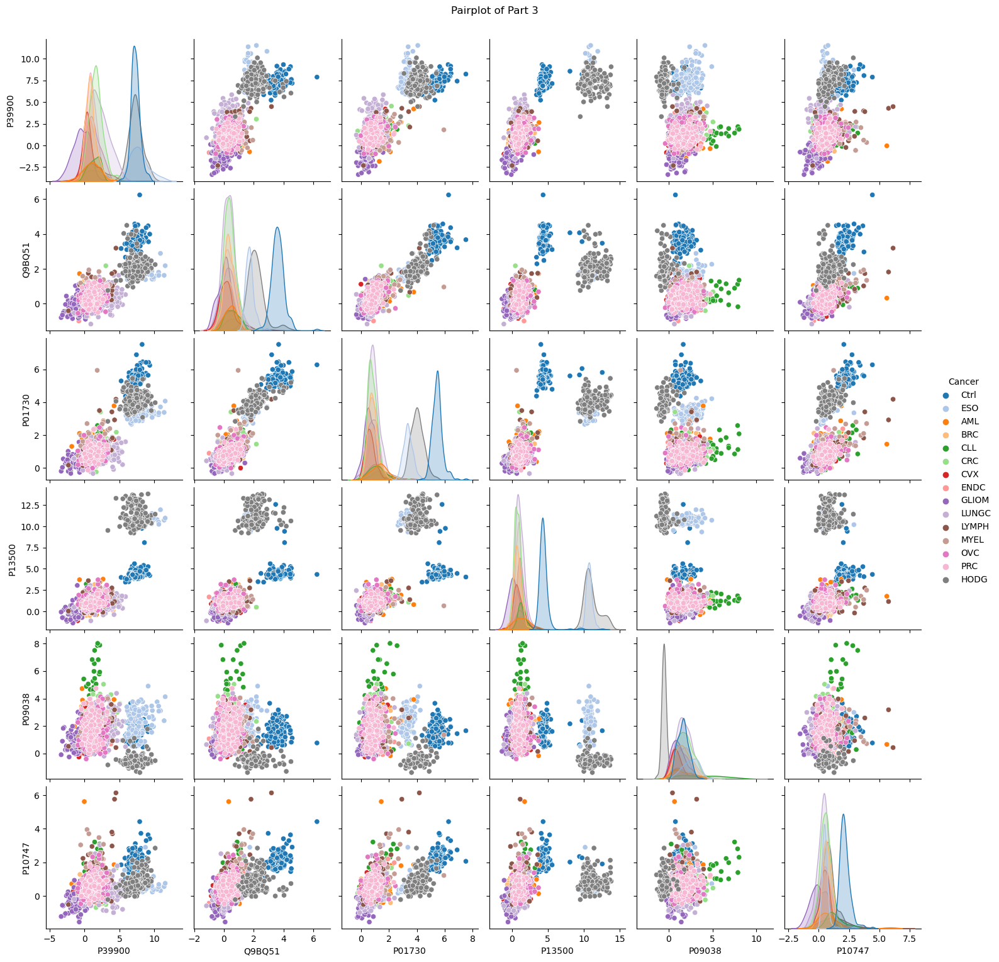

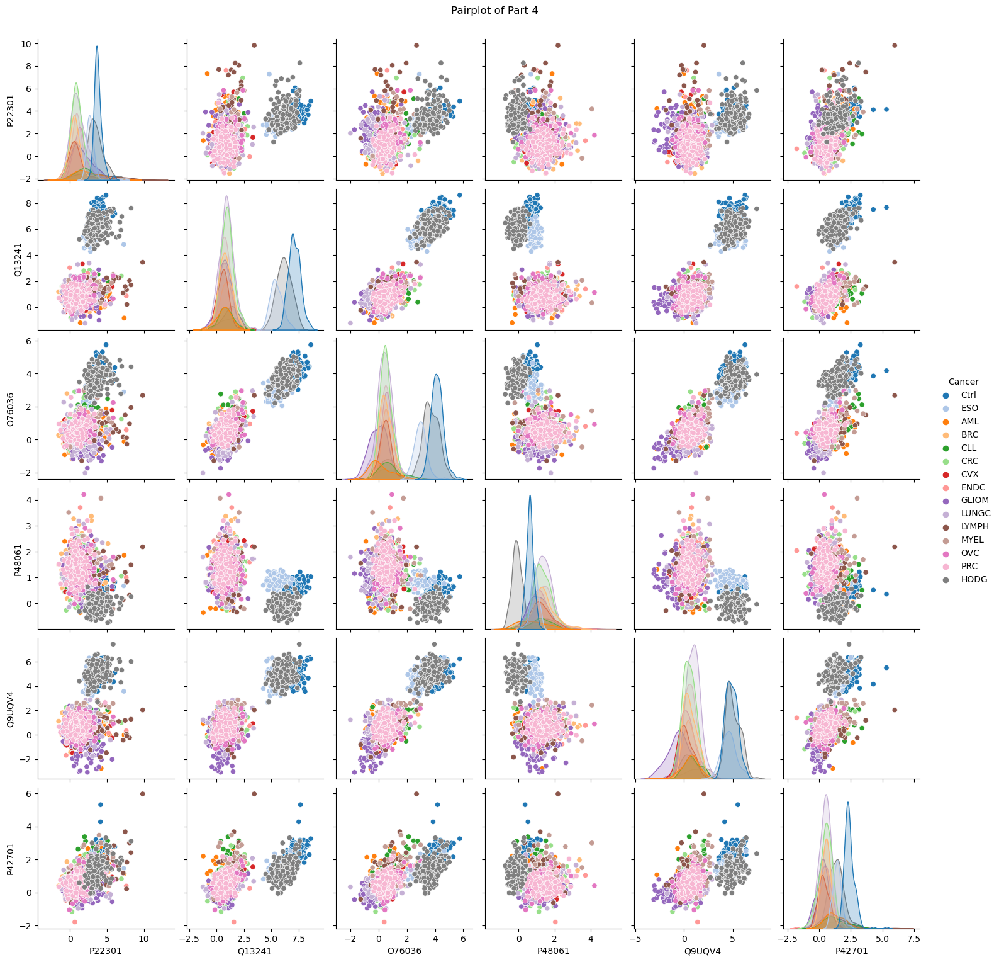

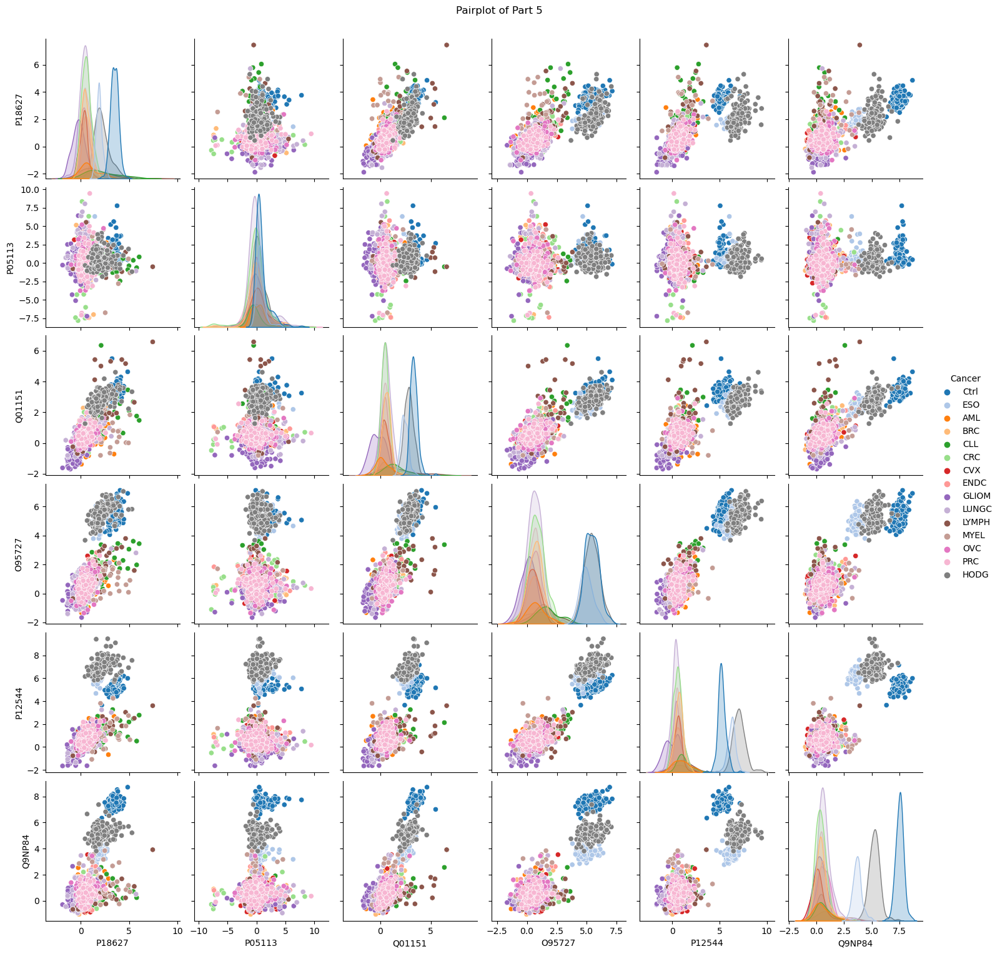

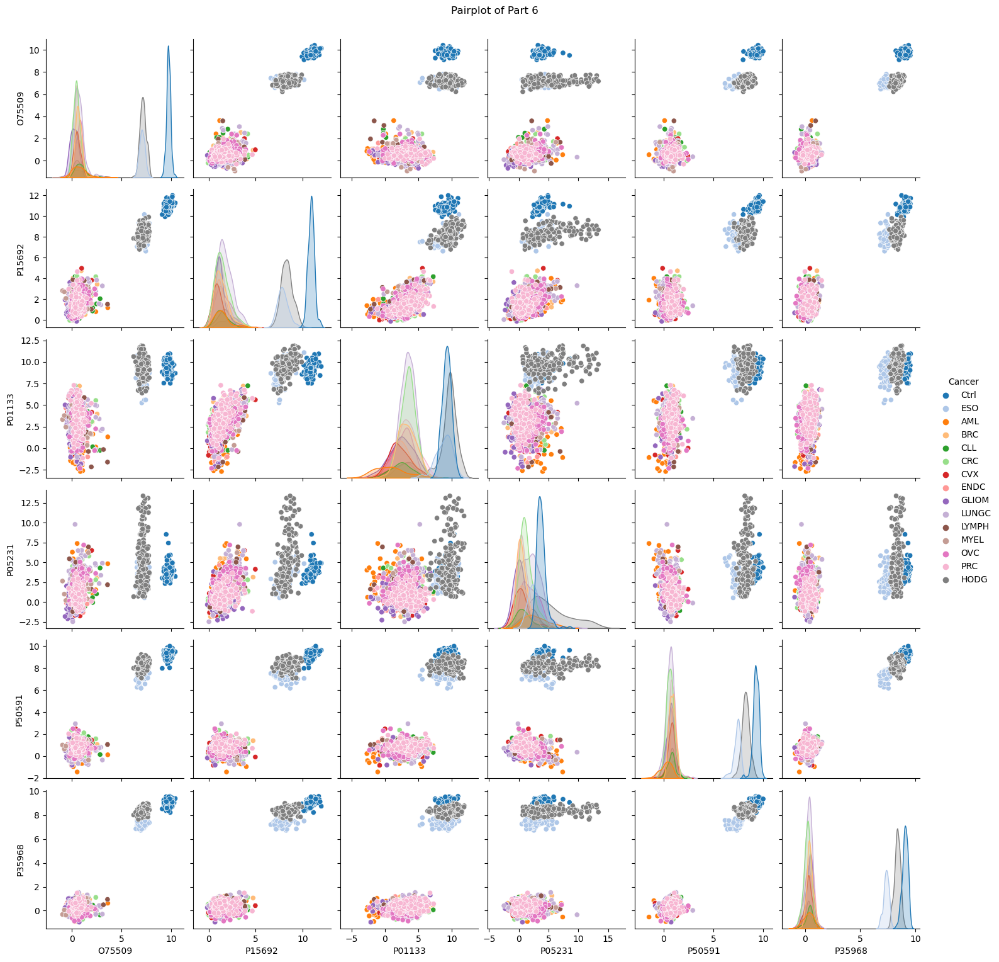

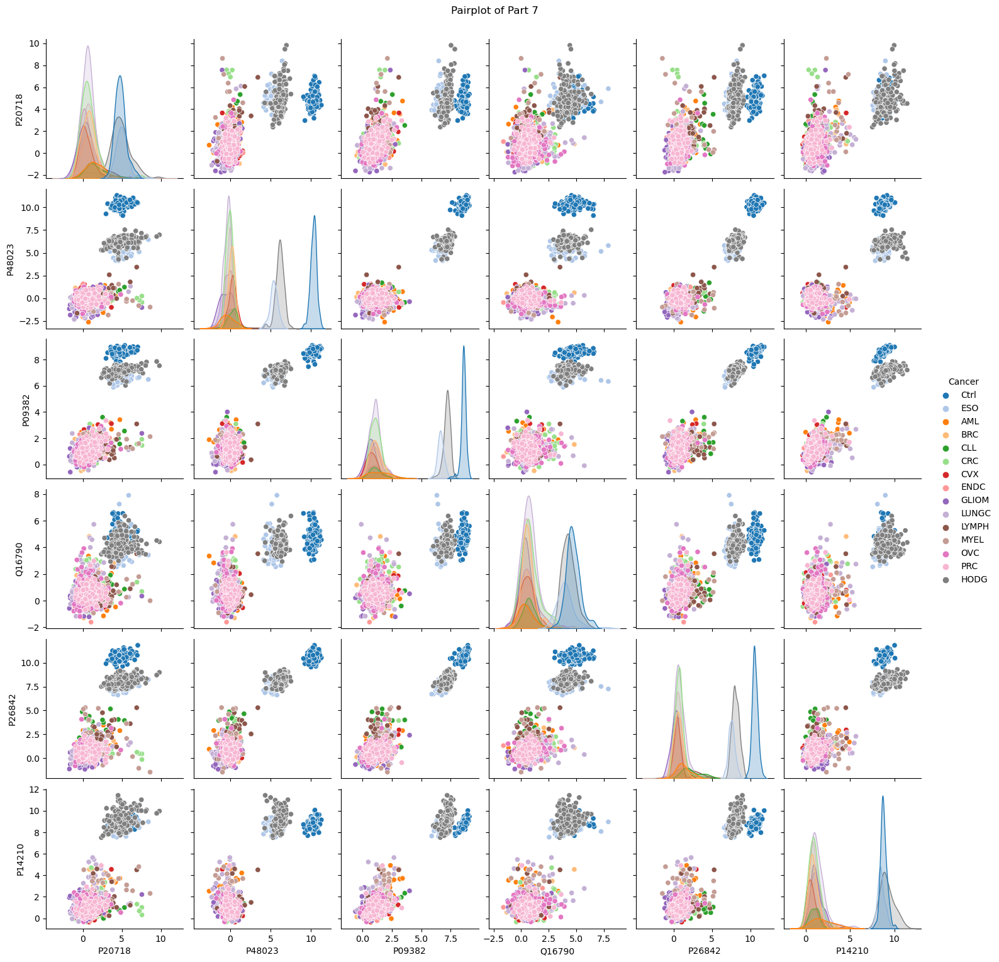

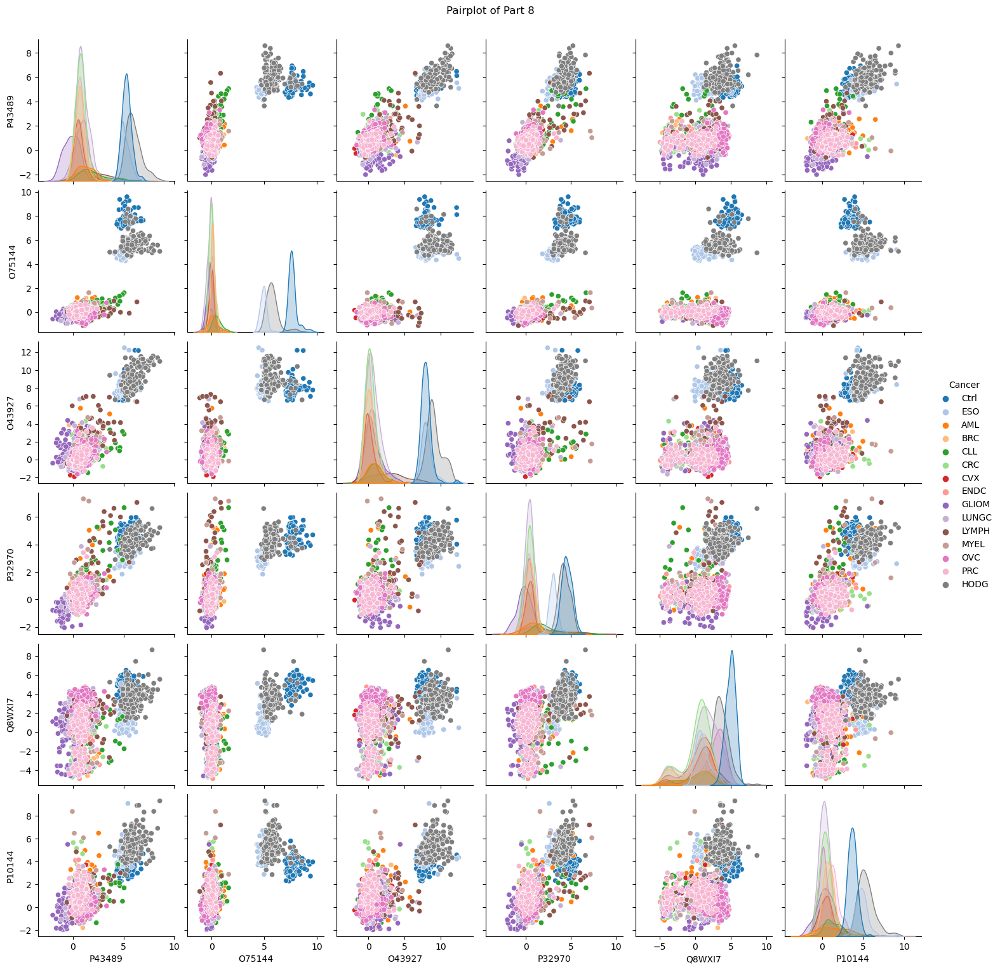

In [77]:
# Define the number of parts
num_parts = 8

# Get feature columns excluding 'Cancer'
features = df_dropped.columns[1:]

# Calculate how many columns to take for each part
split_size = len(features) // num_parts
extra_columns = len(features) % num_parts

df_parts = []

# Create parts
start_index = 0
for i in range(num_parts):
    end_index = start_index + split_size + (1 if i < extra_columns else 0)
    
    # Slice feature columns for this part
    feature_columns = features[start_index:end_index]
    
    # Create a new DataFrame for this part
    df_part = df_dropped[['Cancer'] + list(feature_columns)].copy()  # Use copy to avoid SettingWithCopyWarning
    df_part.columns = df_part.columns.str.strip()  # Strip any whitespace from column names
    df_part = df_part.loc[:, ~df_part.columns.duplicated()]  # Remove duplicate columns
    df_parts.append(df_part)
    
    # Update the start_index for the next part
    start_index = end_index

# Inspect Part 1 Data
part1 = df_parts[0]
#print("Part 1 Data:")
#print(part1)

# Check for data types and NaN values
#print("\nData Types in Part 1:")
#print(part1.dtypes)

#print("\nNaN Values in Part 1:")
#print(part1.isna().sum())



# Plot pairplots for each part
for index, part in enumerate(df_parts):
    if part.shape[1] > 1:  # Ensure there are enough columns to plot
        try:
            g = sns.pairplot(part, hue='Cancer', palette="tab20")
            plt.suptitle(f'Pairplot of Part {index + 1}', y=1.02)  # Title for each part
            # Save the figure
            filename = f'pairplot_part_{index + 1}.png'  # Create a unique filename for each part
            g.fig.savefig(filename, dpi=300, bbox_inches='tight')  # Save as PNG file
            plt.show()
        except Exception as e:
            print(f"Error in part {index + 1}: {e}")

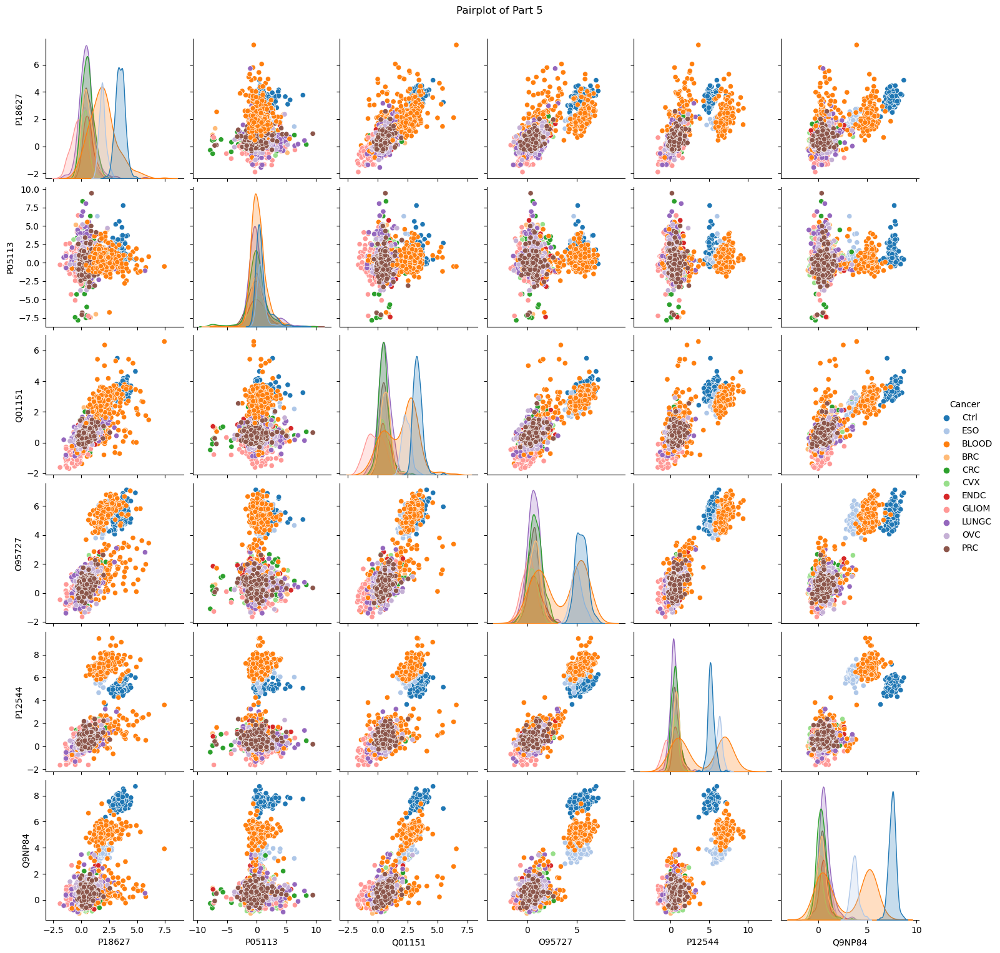

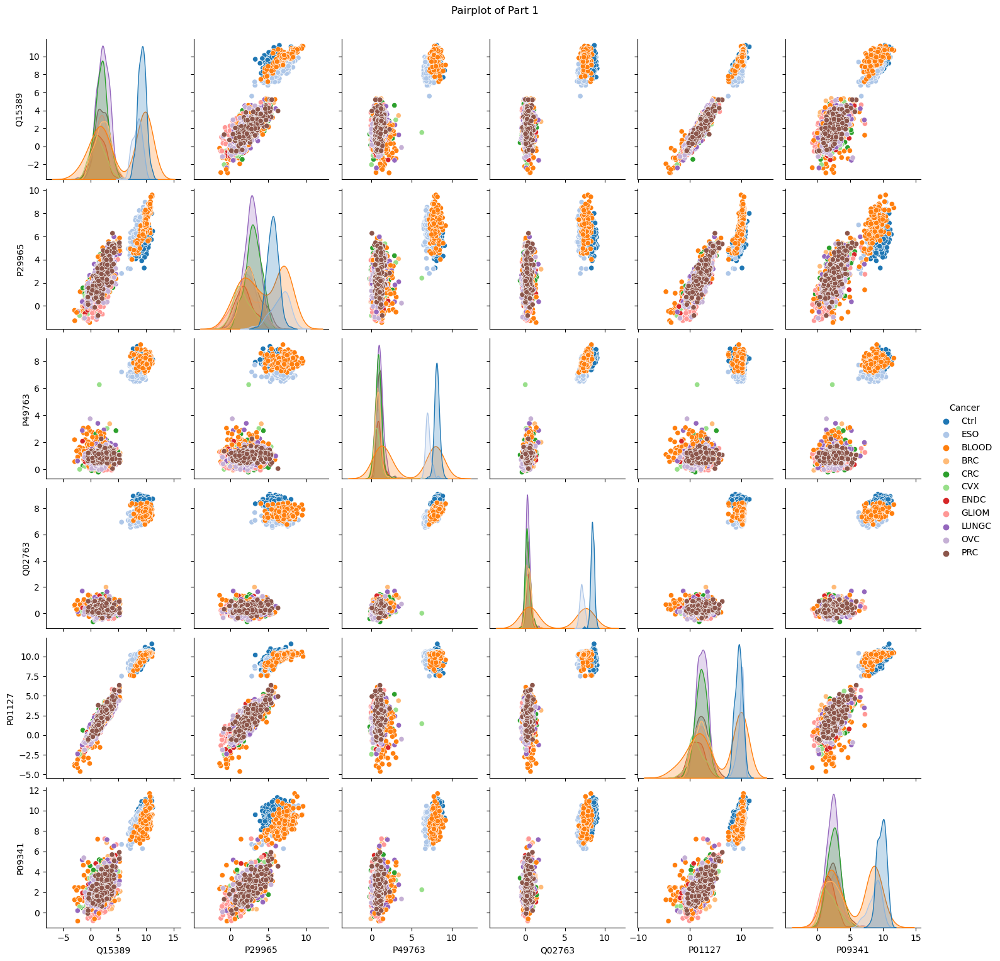

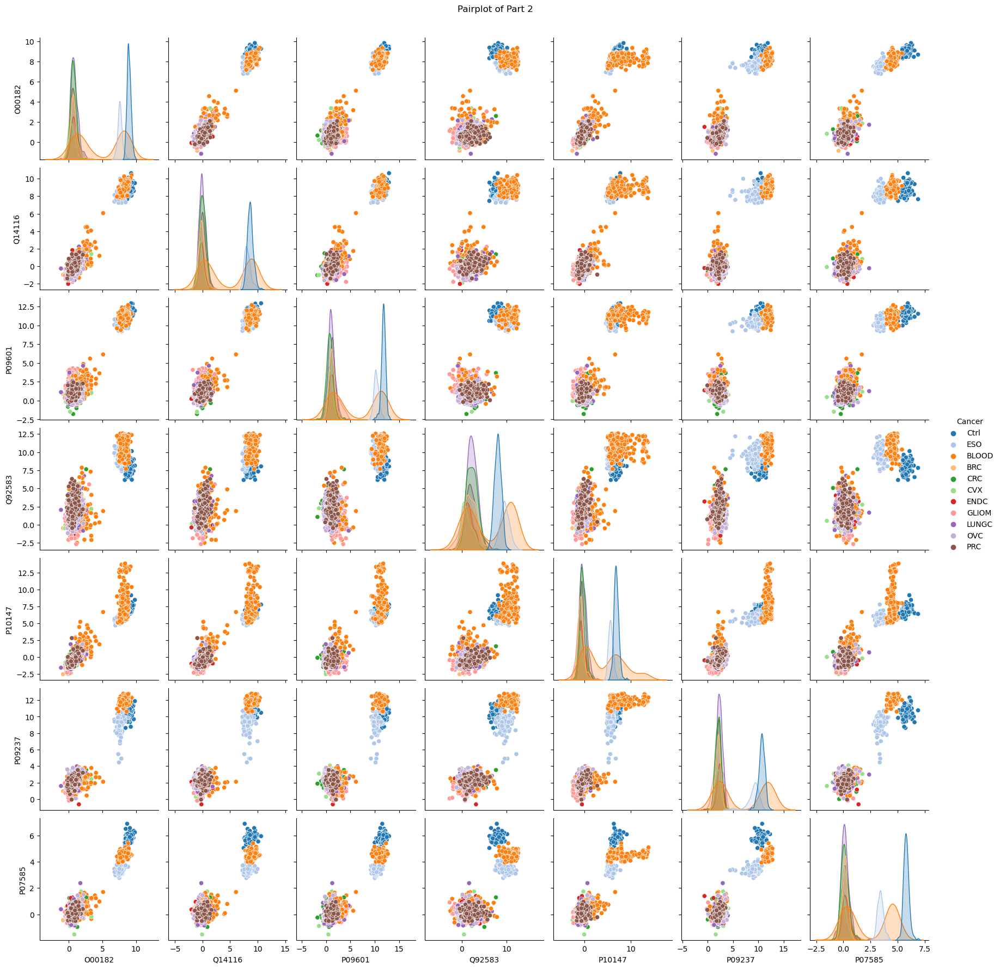

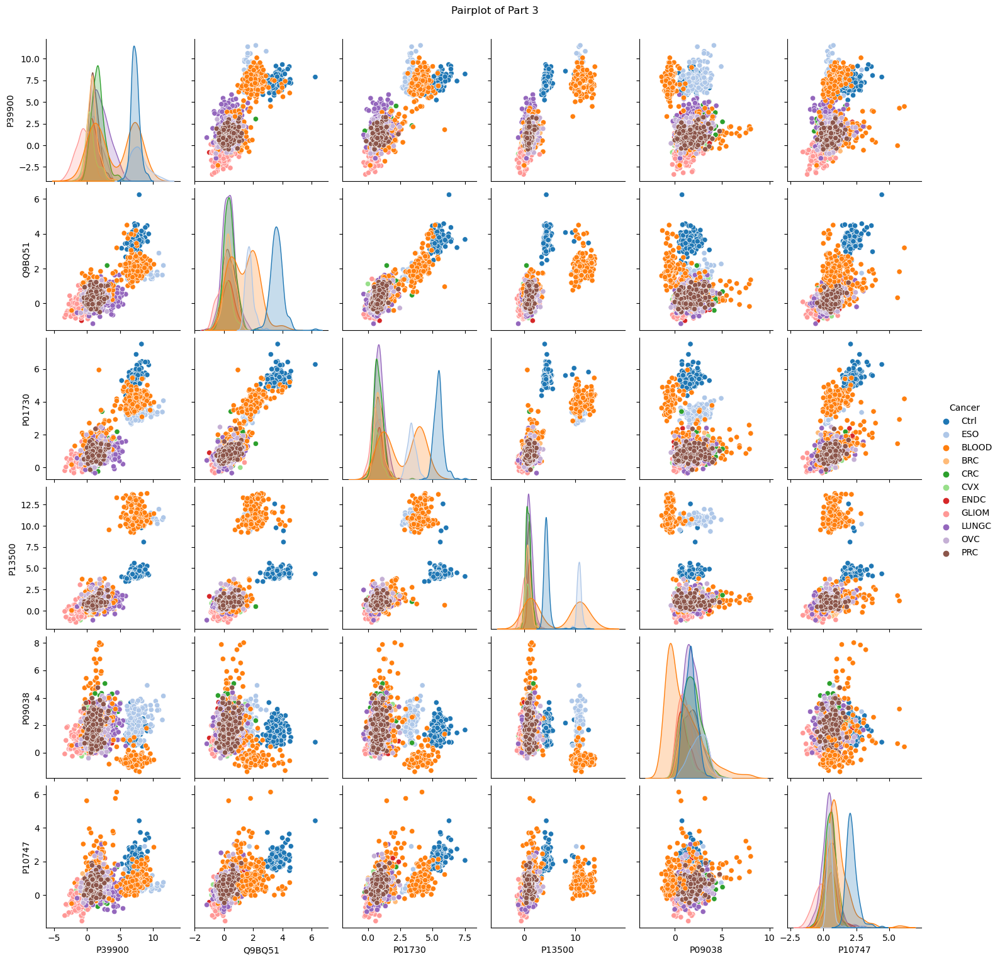

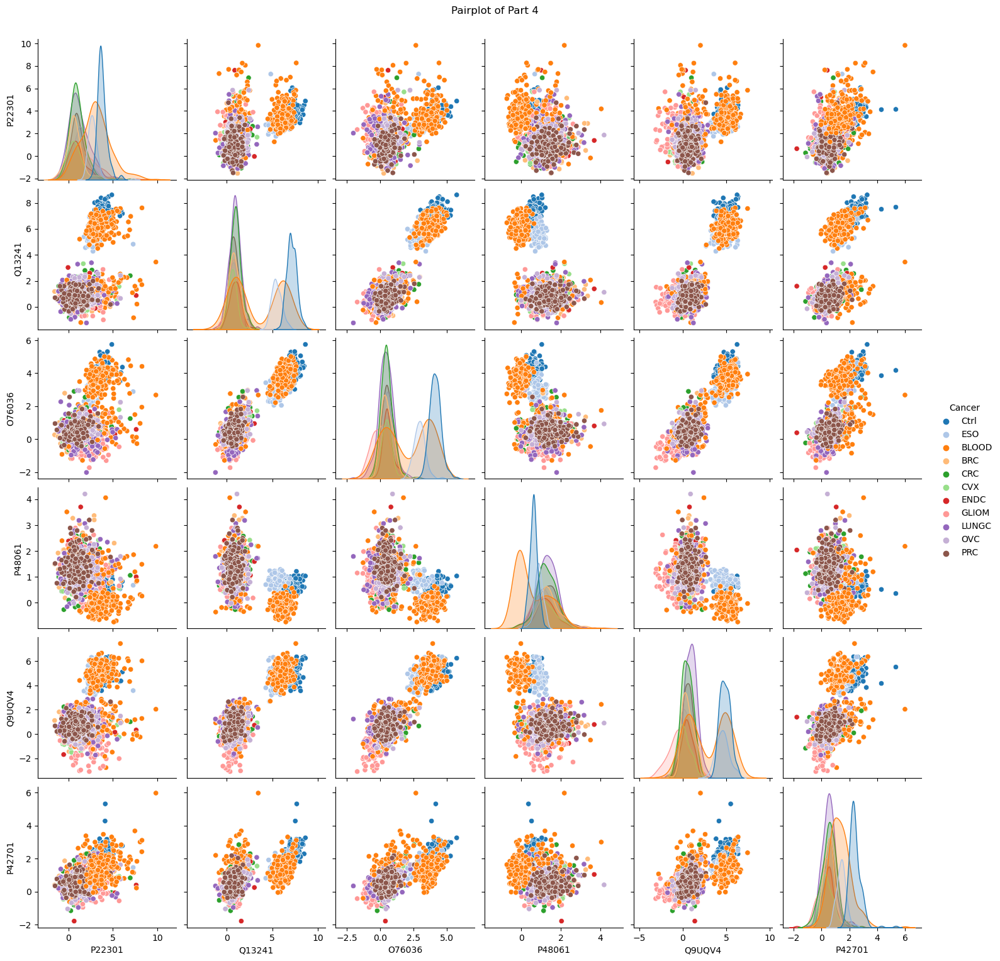

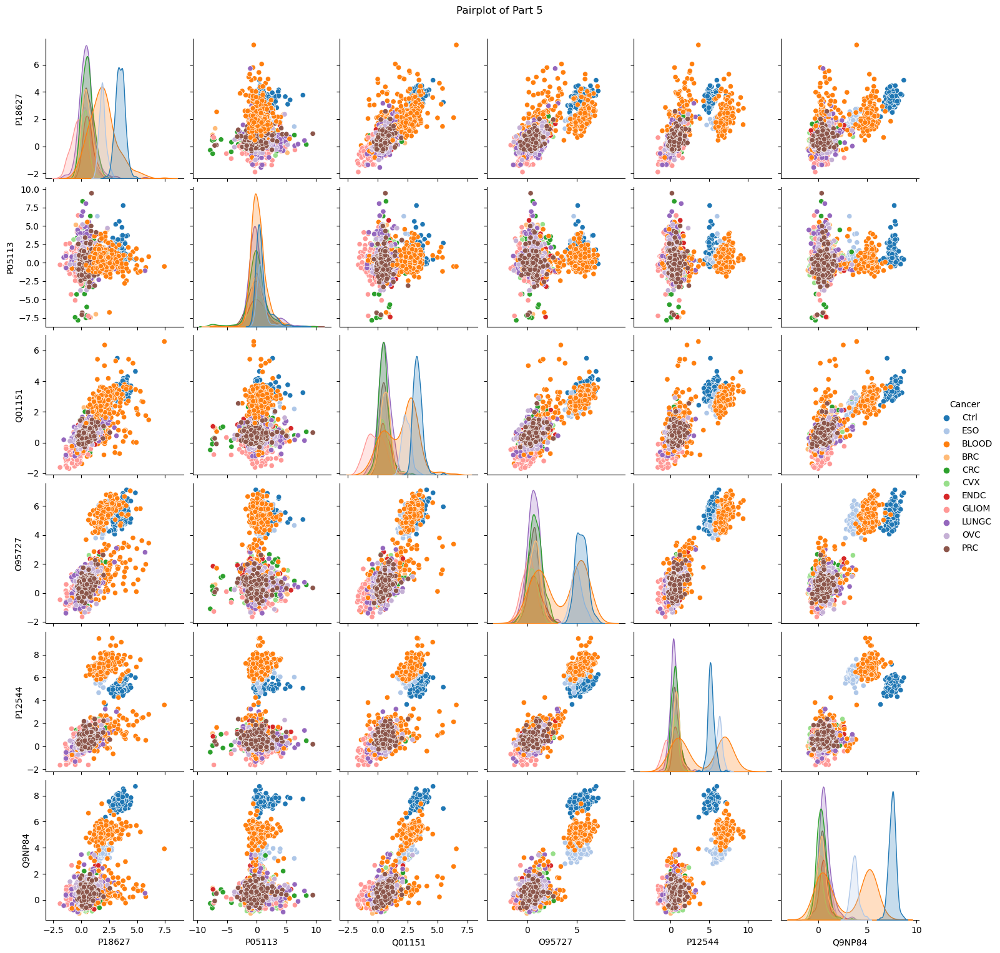

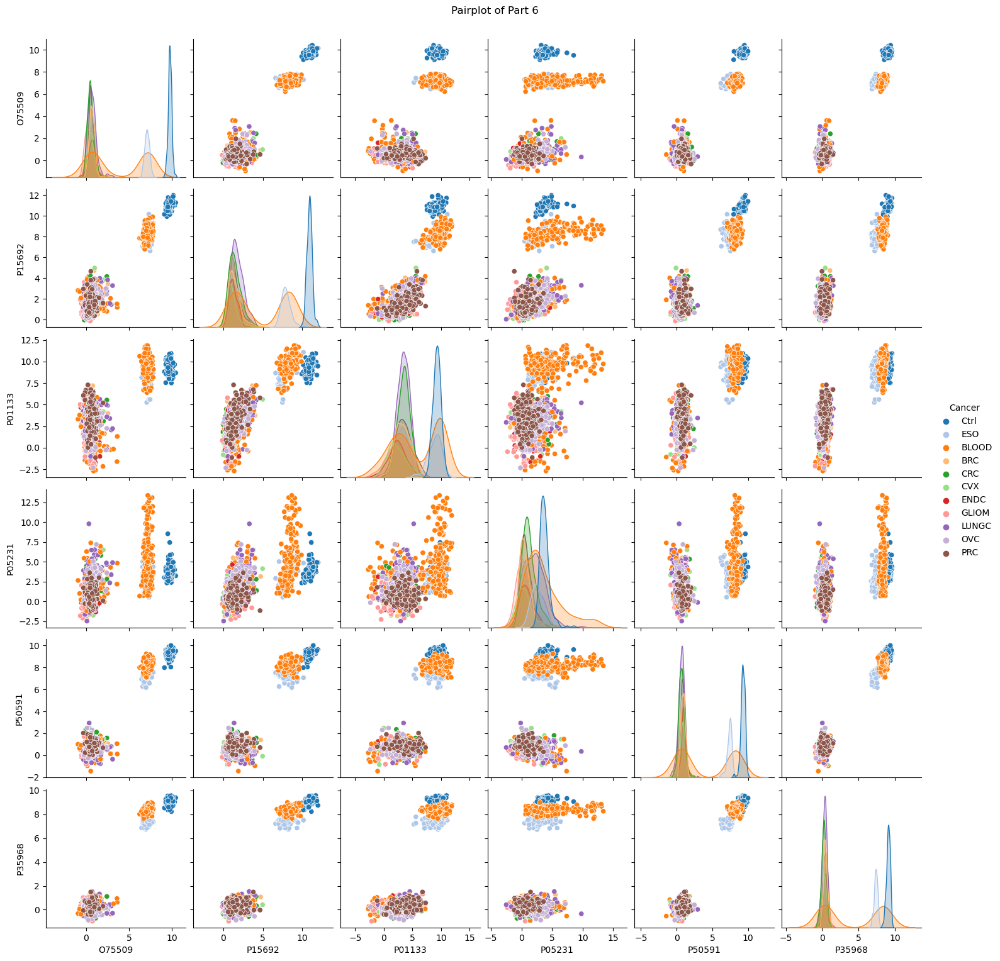

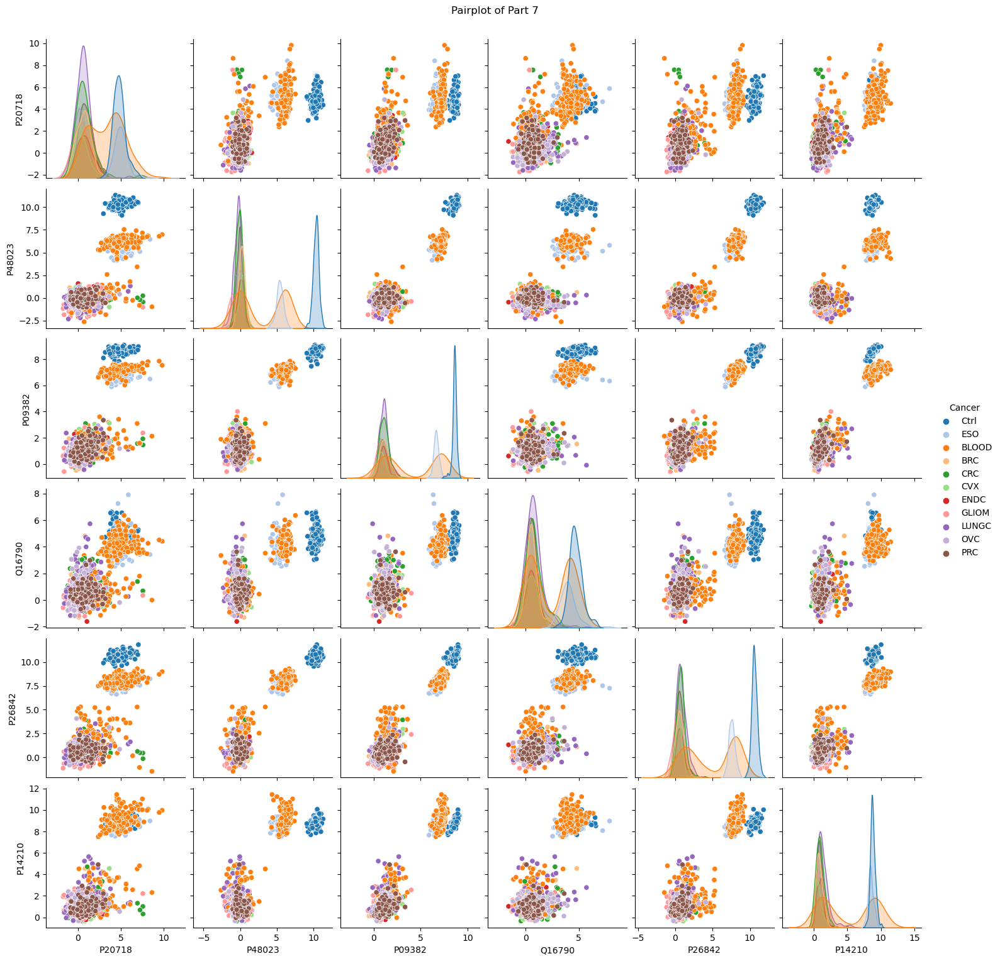

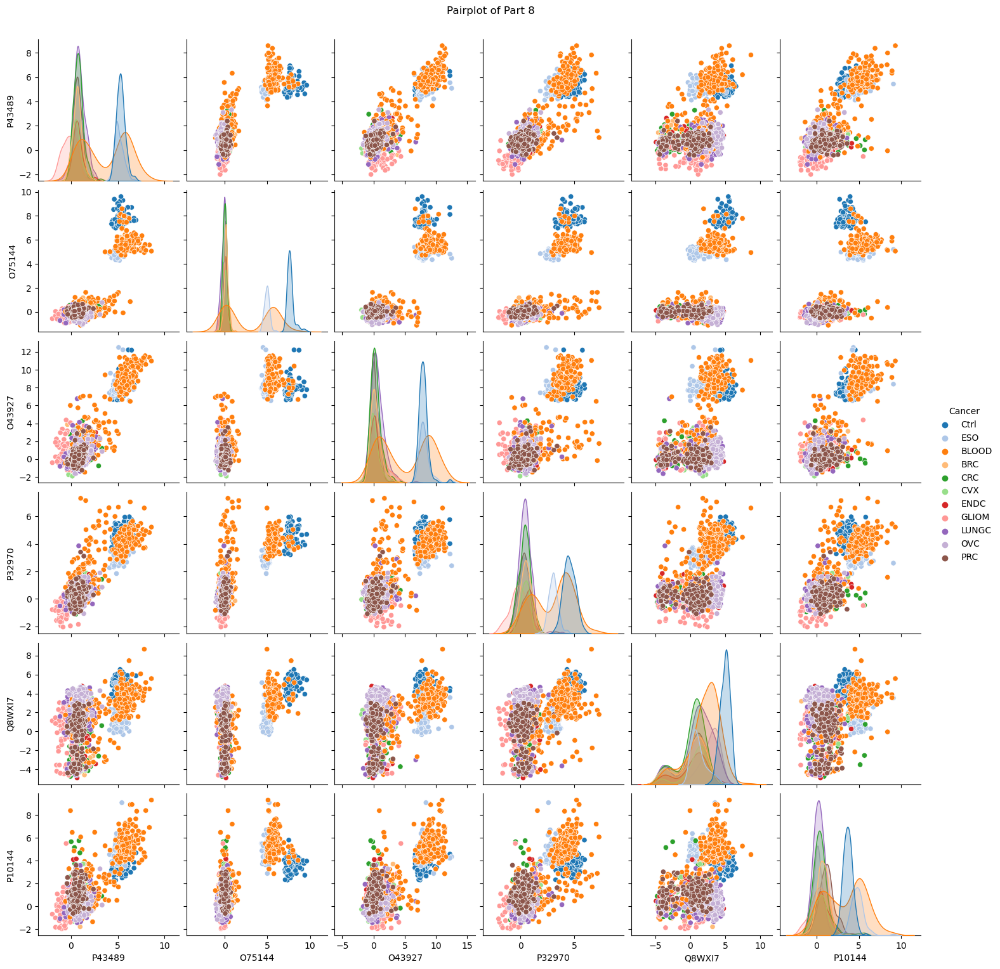

In [74]:
# Combine specified cancer categories into 'BLOOD'
blood_categories = ['AML', 'CLL', 'DLBCL', 'LYMPH','MYEL', 'HODG']
df_dropped['Cancer'] = df_dropped['Cancer'].replace(blood_categories, 'BLOOD')

# Define the number of parts
num_parts = 8

# Get feature columns excluding 'Cancer'
features = df_dropped.columns[1:]

# Calculate how many columns to take for each part
split_size = len(features) // num_parts
extra_columns = len(features) % num_parts

df_parts = []

# Create parts
start_index = 0
for i in range(num_parts):
    end_index = start_index + split_size + (1 if i < extra_columns else 0)
    
    # Slice feature columns for this part
    feature_columns = features[start_index:end_index]
    
    # Create a new DataFrame for this part
    df_part = df_dropped[['Cancer'] + list(feature_columns)].copy()  # Use copy to avoid SettingWithCopyWarning
    df_part.columns = df_part.columns.str.strip()  # Strip any whitespace from column names
    df_part = df_part.loc[:, ~df_part.columns.duplicated()]  # Remove duplicate columns
    df_parts.append(df_part)
    
    # Update the start_index for the next part
    start_index = end_index

# Inspect Part 1 Data
part1 = df_parts[0]
#print("Part 1 Data:")
#print(part1)

# Check for data types and NaN values
#print("\nData Types in Part 1:")
#print(part1.dtypes)

#print("\nNaN Values in Part 1:")
#print(part1.isna().sum())


# Plot pairplots for each part
for index, part in enumerate(df_parts):
    if part.shape[1] > 1:  # Ensure there are enough columns to plot
        try:
            g = sns.pairplot(part, hue='Cancer', palette="tab20")
            plt.suptitle(f'Pairplot of Part {index + 1}', y=1.02)  # Title for each part
            # Save the figure
            filename = f'pairplot_BLOOD_part_{index + 1}.png'  # Create a unique filename for each part
            g.fig.savefig(filename, dpi=300, bbox_inches='tight')  # Save as PNG file
            plt.show()
        except Exception as e:
            print(f"Error in part {index + 1}: {e}")

In [79]:

import seaborn as sns
g=sns.pairplot(df_dropped, hue= "Cancer", palette="tab20", )
# Save the figure
filename = f'pairplot_all.png'  # Create a unique filename for each part
g.fig.savefig(filename, dpi=300, bbox_inches='tight')  # Save as PNG file
fig = plt.gcf()
fig.set_size_inches(20, 20)

In [15]:
# Calculate split indices
total_columns = len(df_dropped.columns)
num_parts = 8  # Number of parts to split into
split_size = total_columns // num_parts  # Number of columns in each part

# Create a list to hold the parts
df_parts = []

for i in range(num_parts):
    start_index = i * split_size
    # Handle the last part to include any remaining columns
    end_index = (i + 1) * split_size if i < num_parts - 1 else total_columns
    df_part = df.iloc[:, start_index:end_index]
    df_parts.append(df_part)

# Display the split DataFrames
for index, part in enumerate(df_parts):
    print(f"\nPart {index + 1} of DataFrame:")
    print(part)


Part 1 of DataFrame:
      Unnamed: 0 Sample_ID Cancer    Q15389   P29965   P49763
0              0     PM910   Ctrl  10.12895  5.62622  7.72902
1              1     PM396   Ctrl   8.67289  5.18821  8.25523
2              2     PM190   Ctrl   9.99567  6.38876  8.44263
3              3     PM270   Ctrl   8.26407  5.06228  8.13429
4              4     PM656   Ctrl   9.08833  5.95005  8.37830
...          ...       ...    ...       ...      ...      ...
1733        1472    PRC_95    PRC       NaN  3.10310  0.79385
1734        1473    PRC_96    PRC   1.40880  2.16410  1.14075
1735        1474    PRC_97    PRC   2.58860  4.10685  1.57825
1736        1475    PRC_98    PRC   3.94170  6.27700  0.05375
1737        1476    PRC_99    PRC   2.83445  3.97695  1.22920

[1738 rows x 6 columns]

Part 2 of DataFrame:
       Q02763    P01127    P09341   O00182   Q14116    P09601
0     8.47530  10.08926  10.58751  8.65712  7.81074  11.03461
1     9.06271   8.89866   9.22360  8.46706  8.18828  11.91449
2

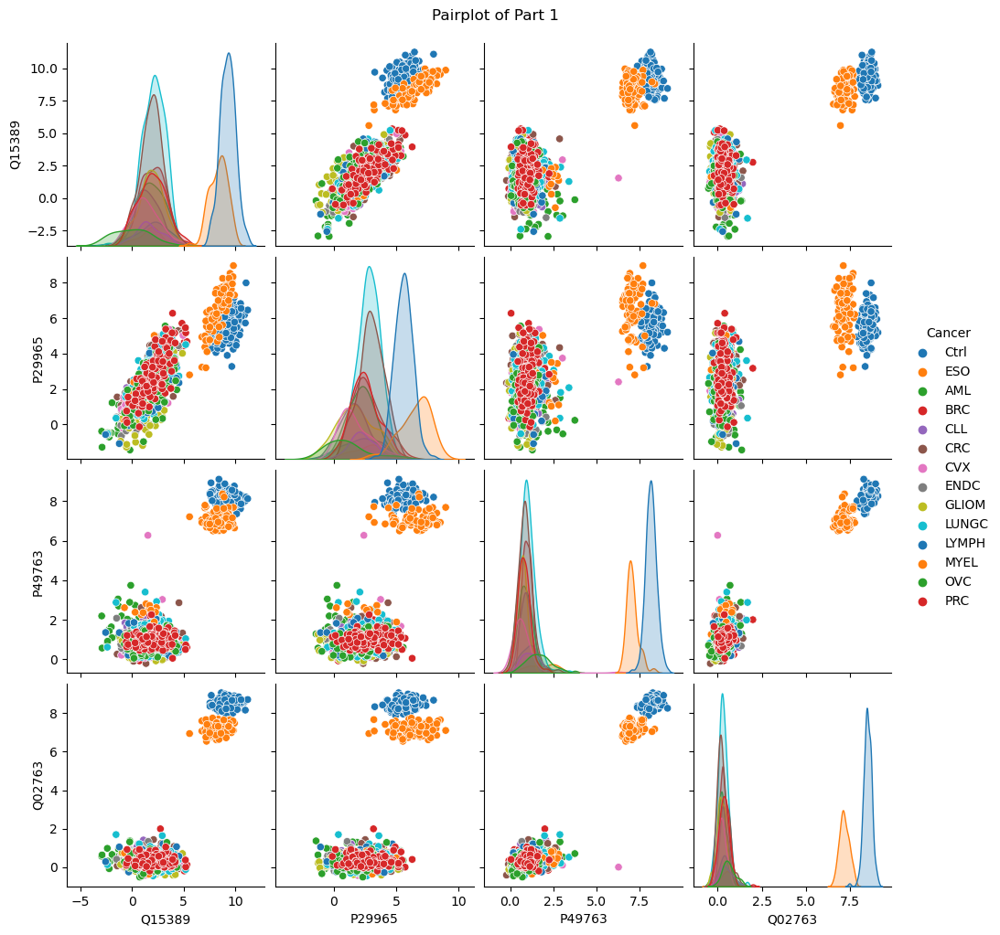

In [20]:
# Split the DataFrame into eight parts
total_columns = len(df_dropped.columns)
num_parts = 8
split_size = total_columns // num_parts

df_parts = []
for i in range(num_parts):
    start_index = i * split_size
    end_index = (i + 1) * split_size if i < num_parts - 1 else total_columns
    df_part = df_dropped.iloc[:, start_index:end_index]
    df_parts.append(df_part)

# Plot pairplots for each part
for index, part in enumerate(df_parts):
    # Check if 'Cancer' is in the part, to use as hue
    if 'Cancer' in part.columns:
        sns.pairplot(part, hue='Cancer', palette='tab10')
        plt.suptitle(f'Pairplot of Part {index + 1}', y=1.02)  # Title for each part
        plt.show()



In [14]:
#perform various analyses, such as aggregating data to calculate the mean NPX values for each cancer type:

mean_values = df.groupby('Cancer').mean()
mean_values


,Unnamed: 0,Q15389,P29965,P49763,Q02763,P01127,P09341,O00182,Q14116,P09601,...,P09382,Q16790,P26842,P14210,P43489,O75144,O43927,P32970,Q8WXI7,P10144
Cancer,,,,,,,,,,,,,,,,,,,,,
AML,24.5,0.186379,1.347301,1.588387,0.578488,-0.435053,2.575240,1.642731,0.649242,2.033980,...,1.412758,0.472829,1.231492,1.918407,1.280894,0.144641,1.145234,1.185057,0.183084,1.461555
BRC,125.5,2.058509,2.651672,0.815068,0.391530,2.229441,2.225854,0.649273,-0.132788,1.109229,...,1.071271,0.633179,0.570713,0.865512,0.660275,0.129591,0.342055,0.456731,0.050416,0.705535
CLL,225.5,1.611826,2.229269,1.148553,0.430829,1.470708,2.060236,1.053495,0.339775,1.319475,...,1.186905,0.731838,2.202630,0.936691,2.029012,0.507337,0.910197,2.155986,0.023328,1.200753
CRC,360.0,1.878539,2.990962,0.874056,0.291599,2.141072,2.445321,0.699081,-0.013867,0.736163,...,1.090603,0.780540,0.701641,0.952604,0.782971,-0.021005,0.324619,0.353095,0.198468,0.502514
CVX,521.5,1.224112,1.687286,0.718188,0.247456,1.269038,1.790550,0.455159,-0.391051,0.817034,...,0.879178,0.530659,0.529670,0.651876,0.618368,0.004587,0.124055,0.367535,0.738284,0.399197
Ctrl,84.5,9.269899,5.570507,8.142155,8.467736,9.524201,9.758807,8.930600,8.639001,11.752207,...,8.475567,4.651575,10.473774,8.672225,5.243818,7.599113,7.849168,4.486050,4.886206,3.631237
ENDC,623.0,1.343633,1.751446,0.929112,0.361749,1.250463,1.858924,0.770425,-0.268444,1.013047,...,1.029516,0.618878,0.650033,0.955039,0.742508,0.052372,0.144948,0.556300,0.296776,0.687163
ESO,45.0,8.385590,6.508712,7.062532,7.153971,9.888668,8.713589,7.599780,8.143809,10.316972,...,6.641808,4.024170,7.572962,8.481803,5.118985,4.918641,8.137025,3.037216,1.224895,4.815457
GLIOM,746.0,1.888243,1.910956,0.663861,0.235211,1.852186,1.786797,0.466923,-0.230360,1.724930,...,0.781306,0.433310,0.194976,1.111356,-0.160627,-0.116363,0.605388,-0.203334,0.397398,0.341946


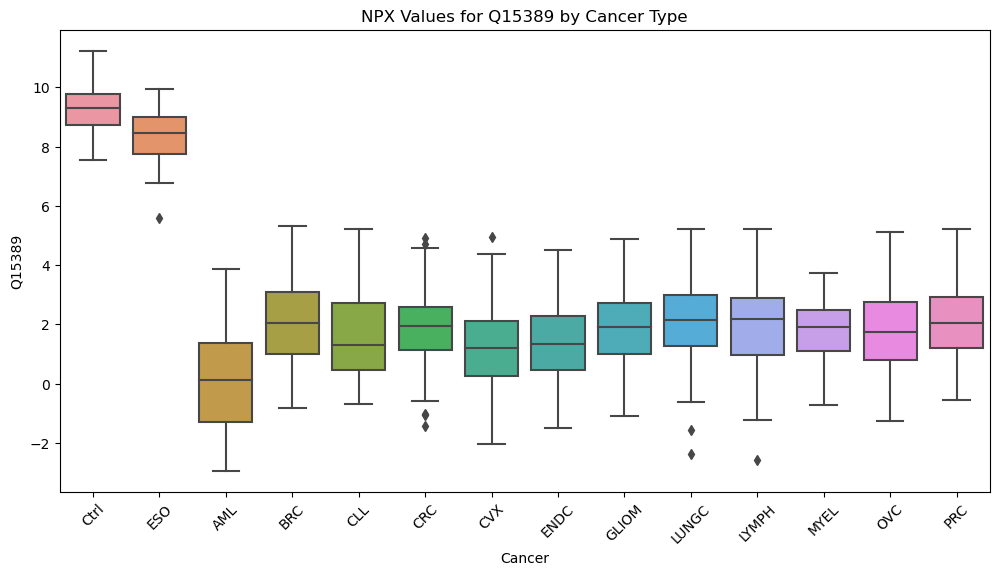

In [15]:
#Visualizations to understand the distribution of the data:

# Example: boxplot of NPX values for different cancers:

plt.figure(figsize=(12, 6))
sns.boxplot(x='Cancer', y='Q15389', data=df)
plt.xticks(rotation=45)
plt.title('NPX Values for Q15389 by Cancer Type')
plt.show()

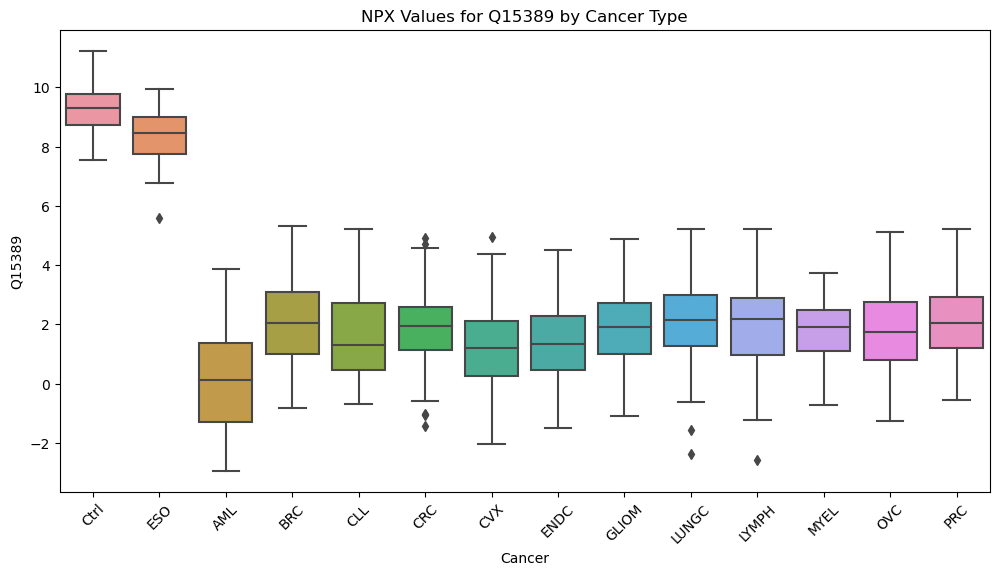

In [26]:
#Visualizations to understand the distribution of the data:

# Example: boxplot of NPX values for different cancers:

plt.figure(figsize=(12, 6))
sns.boxplot(x='Cancer', y='Q15389', data=df)
plt.xticks(rotation=45)
plt.title('NPX Values for Q15389 by Cancer Type')
plt.show()

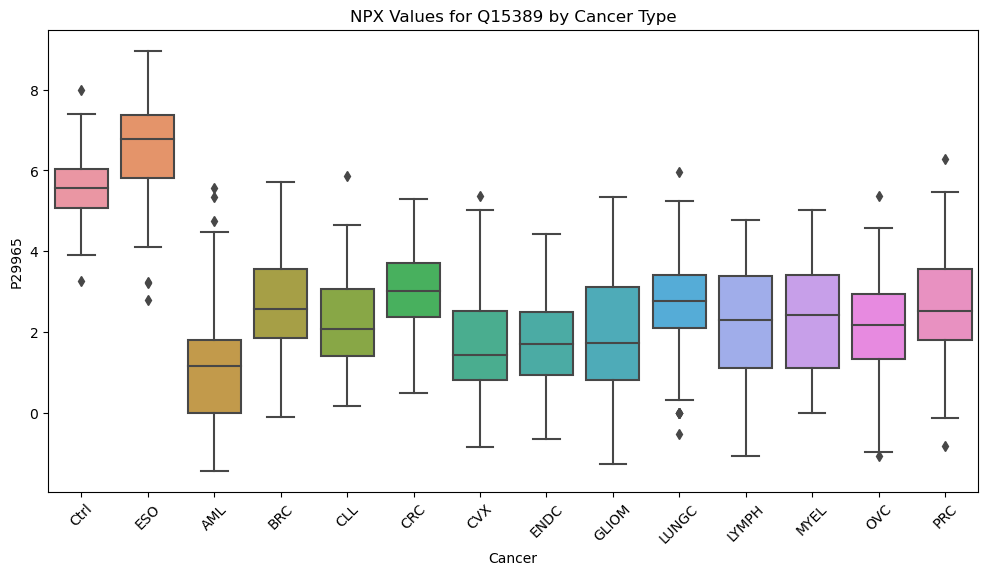

In [27]:
#Visualizations to understand the distribution of the data:

# Example: boxplot of NPX values for different cancers:

plt.figure(figsize=(12, 6))
sns.boxplot(x='Cancer', y='P29965', data=df)
plt.xticks(rotation=45)
plt.title('NPX Values for Q15389 by Cancer Type')
plt.show()